# Introduction 
he goal of this capstone is to identify three stocks to invest in, using the criteria of my momentum trading strategy_. The population of stocks considered will be all stocks in the NYSE and the NASDAQ. These stocks will be identified by:    
    1. Stock scan of the enitre market based on key parameters    
    2. Creating interactive charts of filtered stock watch list   
    3. Modeling - Gradient Boosting, CNN, LSTM, and ARIMA
    
# Stock Scan 
The stock scan function below scrapes from two different APIs: NASDAQ.com and Tiingo.com. A list of stock tickers is generated and pulled from NASDAQ.com. The historical stock prices are then pulled from Tiingo.com and passed through a series of logic tests to filter further. Stocks that pass these logic test are appended to the stock watch list. The logic tests are as follows and will create a watchlist:
   
   1. Does the stock exhibit a bullish trend? I.e. is the 20 moving average (MA) > 50 MA > 200 MA. If these moving averages are in the right order, the chart should show a stock that exhibits a bullish trend.
   
   
   2. Is the current stock in a bollinger band squeeze? Bollinger bands are a statistical chart indicator that show the prices and volatiliy over time. Gernerally they represent the potental price action within two standard deviations. Meaning, that 95 percent of the price with fall somewhere within the band. A bollinger band squeeze occurs when the bands tighten. This indicates a drop in voliatility and most likely a spike in volatility will happen in the next few trading days. A stock that is bullish will breakout to the positive.
   
   
   3. Does the stock have a minimum average volume of over 500k a day. A low trade float indicates high volatility, large bid/ask spreads, and overall illiquidity. Meaning if the trade goes sour it will result in a painful lesson to our portfolio, through a significant loss of value, and so is best avoided all together. 
   
   
   4. Is the stock close to the all time high? If a stock is close to its all time high, it has the tendency to test its high. The high acts like a ceiling, and it is easy to set up a trading strategy around it. Once the ceiling is broken, a stock typically moves higher, as there is no longer any selling pressure as buyers pour in fear of missing out (FOMO).
   
   
   5. Has the stock achieved a minimum of 10 percent ROI in the last year? This filter is to remove stocks that just slowly trade sideways. The ideal holding period for this form of trading is 10 - 20 days max. A stock with a low ROI will never see the gains this strategy requires within the holding period. 
   
   
   6. Is the stock within the 2 percent of the 50 MA? This is to identify stocks within an ideal entry point that awe expect to trend up after purchase.  

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import time
from sklearn.preprocessing import StandardScaler, normalize
import warnings

# Create Chart
import alpaca_trade_api as tradeapi
import chart_studio.plotly as py
import plotly.graph_objects as go
from plotly import tools
from ipynb.fs.defs.add_features import add_features
from ipynb.fs.defs.create_chart import create_chart
from ipynb.fs.defs.roi_calc import roi_calc

# Market Scan
import os
import pandas_datareader as pdr
import time
from ipynb.fs.defs.market_scan import stock_scan

# Gradient Boosting 
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
import random 

# Time Series / ARIMA
from statsmodels.tsa.stattools import pacf
from statsmodels.tsa.arima_model import ARIMA
from pandas.plotting import autocorrelation_plot
from sklearn import metrics
from datetime import datetime, timedelta
from pmdarima import auto_arima

# Keras
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Flatten
from keras.layers.convolutional import Conv1D
from keras.layers.convolutional import MaxPooling1D
from keras.layers import LSTM, Dropout
from keras.callbacks import EarlyStopping

%matplotlib inline
warnings.filterwarnings('ignore')

Using TensorFlow backend.


In [2]:
# Tiingo API
api = 'super secret api'

# Run stock scan and print watch list
watch_list = stock_scan(api)
print(watch_list)

There are 3533 stocks in the NASDAQ
There are 3130 stocks in the NYSE
There are a combined total of 6090 stocks

--- 4650.042723417282 seconds ---
['CY', 'GNTX', 'PEGI', 'PAYX', 'ZNGA', 'ADSW', 'ALL', 'BAH', 'DRE', 'FNF', 'HIG', 'KKR', 'LMT', 'MAA', 'EDU', 'OKE', 'RSG', 'REXR', 'SRE', 'SO', 'STAG', 'UTX', 'V']


In [3]:
# print length of watchlist
print('There are {} stock in the watch list'.format(len(watch_list)))

There are 23 stock in the watch list


## Stock Scan Results
The Stock scan produced an interesting list. It produced some very recognizable companies such as Lockheed Martin, and Visa. It also produced companies that are more obscure such as Pattern Energy Group. Let’s see how the charts of these stocks compare.

# Stock charts and Exploration
A stock chart will be produced below for each stock in the watchlist. There are several items that one is looking for. One, is to find any stocks that have a massive gap in their price action followed by sideways trading. These stocks do not have any momentum and will be dropped from the list. Second, is to make sure that the remaining stocks have charts that follow our filters above. The charts show the following items:

    1. OHLC candlesticks - these tell us the open, high, low, and close prices for each day. A green candle means it closed higher than it opened. A red candle indicates that it closed lower.
    2. Bollinger bands - the center line is typically the 20 MA. These are the potential price range of the stock. A stock has the propencity to move towards the center.
    3. 20 MA, 50 MA, and 200 MA - These technical indicators are strong support lines for the trend. When the trend line is broken the stock momentum will run out of steam and trade sideways. 
    4. Volume and average volume – This is a very interesting indicator. When the volume spikes with no tangible new from the company (such as earnings) it means that institutions are either buying or selling the stock. Institutions are banks, hedge funds, or brokerages. This can be an early indicator for future stock trend.

In [4]:
# Generate chart for each stock in the watch list
for x in watch_list:
    create_chart(x, api)

In [5]:
# Remove non ideal stocks from watch list
unloved = ['CY', 'ADSW']
for x in unloved:
    watch_list.remove(x)

# print length of watchlist
print('There are {} stock in the watch list'.format(len(watch_list)))

There are 21 stock in the watch list


# Modeling
The goal of this section is to produce a model that can forecast stock prices. Four models will be implemented below:

    1.	Gradient Boosting
    2.	Convolutional Neural Network
    3.	Long Short-Term Memory
    4.	ARIMA 

One ticker from the list will be selected and run through the four models, from there a model will be chosen and all the tickers will be run through the selected model, which in this case is PEGI. Additional features will be calculated from the OHLC data scraped from the Tiingo API. These features are the moving averages, the bollinger bands, and the average volume for each selected stock.

In [29]:
# Scrape API for historical data from the first ticker
# on watch list
df = pdr.get_data_tiingo(watch_list[1], api_key=api)
df = df.tail(1000)
df.reset_index(inplace=True)
df.index = df['date']

# Add MA, BB, and Average Volume
df = add_features(df)
df = df.tail(800)
df.tail()

,symbol,date,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,divCash,high,...,splitFactor,volume,20MA,50MA,200MA,20_day_std,upper_band,lower_band,width_%,avg_volume
date,,,,,,,,,,,,,,,,,,,,,
2019-11-27 00:00:00+00:00,PEGI,2019-11-27 00:00:00+00:00,27.800,27.83,27.38,27.42,1415508,27.800,0.0,27.83,...,1.0,1415508,27.43950,27.1439,24.113125,0.220746,27.880991,26.998009,3.217927,2128100.25
2019-11-29 00:00:00+00:00,PEGI,2019-11-29 00:00:00+00:00,27.520,27.66,27.47,27.56,321384,27.520,0.0,27.66,...,1.0,321384,27.41400,27.1461,24.146225,0.173301,27.760602,27.067398,2.528646,2082800.55
2019-12-02 00:00:00+00:00,PEGI,2019-12-02 00:00:00+00:00,27.420,27.50,27.39,27.50,851897,27.420,0.0,27.50,...,1.0,851897,27.39500,27.1467,24.178375,0.147693,27.690386,27.099614,2.156493,2092659.95
2019-12-03 00:00:00+00:00,PEGI,2019-12-03 00:00:00+00:00,27.375,27.42,27.23,27.36,491425,27.375,0.0,27.42,...,1.0,491425,27.40825,27.1494,24.209850,0.131812,27.671874,27.144626,1.923684,1335102.75
2019-12-04 00:00:00+00:00,PEGI,2019-12-04 00:00:00+00:00,27.460,27.49,27.34,27.40,443034,27.460,0.0,27.49,...,1.0,443034,27.41675,27.1524,24.241950,0.129241,27.675233,27.158267,1.885584,1007218.15


# Importance of Stationarity
Stationary is the concept that the statistical properties of a time series do not change over time. This does not mean that the time series does not change, but rather the way it changes remains the same. See the chart below of the close price being transformed to a stationary process. The slope shifted to zero, which allows easier data analysis than that of non-stationary ones. This will help boost the accuracy of the models used below to predict stock movement. 


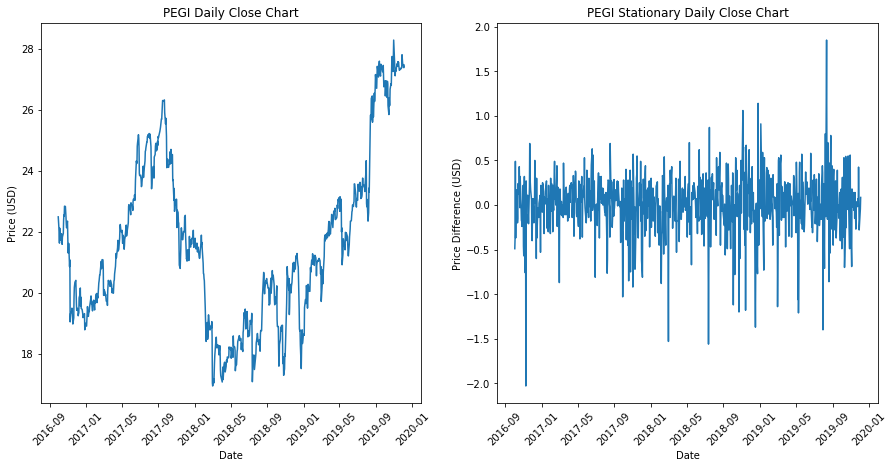

In [32]:
# Create new variable for stationary transformation of closing price
df['close_diff'] = df['close'] - df['close'].shift()

plt.figure(figsize=(15, 7))

# Plot chart of closing prices
plt.subplot(1, 2, 1)
plt.plot(df.index, df['close'])
plt.title('{} Daily Close Chart'.format(watch_list[1]))
plt.xticks(rotation=45)
plt.ylabel('Price (USD)')
plt.xlabel('Date')

# Plot chart of stationary closing price
plt.subplot(1, 2, 2)
plt.plot(df.index, df['close_diff'])
plt.title('{} Stationary Daily Close Chart'.format(watch_list[1]))
plt.xticks(rotation=45)
plt.ylabel('Price Difference (USD)')
plt.xlabel('Date')
plt.show()

## Correlation
Before the modeling occurs, lets take a quick look through the correlations of each variable to one another. Not surprisingly, the features that were calculated are highly correlated with one another. These features will not be removed to see if the minute differences can generate a better model. 

In [33]:
# Drop unneeded columns
df.drop(['symbol', 'date', 'adjClose', 'adjHigh', 'adjLow', 
         'adjOpen', 'adjVolume', 'splitFactor'], axis=1, inplace=True)

# Drop any NA rows
df = df.dropna()
df.tail()

,close,divCash,high,low,open,volume,20MA,50MA,200MA,20_day_std,upper_band,lower_band,width_%,avg_volume,close_diff
date,,,,,,,,,,,,,,,
2019-11-27 00:00:00+00:00,27.800,0.0,27.83,27.38,27.42,1415508,27.43950,27.1439,24.113125,0.220746,27.880991,26.998009,3.217927,2128100.25,0.425
2019-11-29 00:00:00+00:00,27.520,0.0,27.66,27.47,27.56,321384,27.41400,27.1461,24.146225,0.173301,27.760602,27.067398,2.528646,2082800.55,-0.280
2019-12-02 00:00:00+00:00,27.420,0.0,27.50,27.39,27.50,851897,27.39500,27.1467,24.178375,0.147693,27.690386,27.099614,2.156493,2092659.95,-0.100
2019-12-03 00:00:00+00:00,27.375,0.0,27.42,27.23,27.36,491425,27.40825,27.1494,24.209850,0.131812,27.671874,27.144626,1.923684,1335102.75,-0.045
2019-12-04 00:00:00+00:00,27.460,0.0,27.49,27.34,27.40,443034,27.41675,27.1524,24.241950,0.129241,27.675233,27.158267,1.885584,1007218.15,0.085


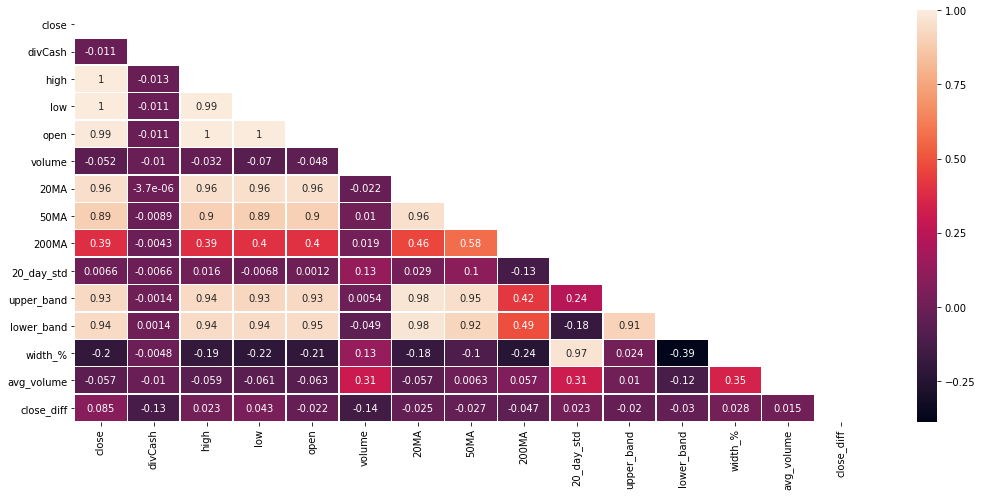

In [34]:
# plot correlation heatmap
df_cor = StandardScaler().fit_transform(df)
df_corr = df.corr()

# Plot correlation heatmap
plt.figure(figsize=(15, 7))

# Clean up the heatmap and remove repeat values
mask = np.zeros_like(df_corr)
mask[np.triu_indices_from(mask)] = True

# PLot the heatmap of the correlations
sns.heatmap(df_corr, annot=True, linewidths=.5, mask=mask)
plt.tight_layout()
plt.show()

# Gradient Boosting Regressor
Gradient boosting is an excellent ensemble model. It achieves this by converting weak learners into strong ones. Each new tree is fit on a modified version of the original dataset. This is done by assigning weights to each observation. Through each tree the weights are adjusted and tuned.

Even though gradient boosting results in excellent models, the parameters will be hypertuned to further increase the accuracy of the stock price change forecast. The following parameters were selected to go into a hyperparameter grid search:

    1.	n_estimators – number of boosting stages to perform
    2.	max_depth – depth of regression estimators in the tree
    3.	learning _rate – contribution of each tree
    4.	min_samples_split – minimum samples required for split a node
    5.	min_samples_leaf - minimum samples required for split a leaf

To find the ideal parameters, rather that iterate through each number in a range. Random integers will be selected to find the closest to ideal parameters. This will drastically reduce the running time but get close to perfect results. 


In [35]:
def Rand(start, end, num): 
    """ Return: List of random integers
    
    Parameters:
    start(int): Minimum list point
    end(int): Maximum list point
    num(int): Length of list"""
    
    res = [] 
    for j in range(num): 
        res.append(random.randint(start, end)) 
    return res 

## Standardization
The train and test set will be seperated before standardization of the features as the higher values of the test set will skew the training set. The test set will be standardized with the mean and standard deviation of the training set. If the testing set  were standardized with the training data or standardized  seperately it would leak information and cause optimism bias in the model. The idea in the model validation is to mimic the situation the model will be making production decisions. 

## Mapping
The training and test set needs to be remapped in order to use the current date to predict the future date. As such, all the target variables ('close price difference') were set to one day in the future. By doing this the model will be trained to predict one day in the future based on the current features.

In [36]:
# Split train and test data
train_set = df.head(780)
test_set = df.tail(20)

# Map data to training features and target variable
train_features = train_set.drop('close_diff', axis=1).iloc[:779]
X_train = StandardScaler().fit_transform(train_features)
Y_train = train_set['close_diff'].iloc[1:]

# Map data to test features and target variable
test_features = test_set.drop('close_diff', axis=1).iloc[:19]
X_test = (test_features - train_features.mean()) / train_features.std()
Y_test = test_set['close_diff'].iloc[1:]

In [37]:
# Number of trees in random forest
n_estimators = Rand(5, 1000, 10)
n_estimators.append(10)

# Maximum number of levels in tree
max_depth = Rand(1, 10, 3)
max_depth.append(None)

# Minimum number of samples required to split a node
learning_rate = [.01, .1, .2]

# Minimum number of samples required to split a node
min_samples_split = Rand(2, 10, 3)

# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 3, 4]


# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
               'learning_rate': learning_rate,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf
              }

print(random_grid)

{'n_estimators': [212, 933, 452, 841, 981, 738, 419, 63, 722, 944, 10], 'max_depth': [3, 5, 2, None], 'learning_rate': [0.01, 0.1, 0.2], 'min_samples_split': [4, 2, 9], 'min_samples_leaf': [1, 2, 3, 4]}


In [38]:
# Use the random grid to search for best hyperparameters
gbr = GradientBoostingRegressor()

# Random search of parameters, using 2 fold cross validation, 
# Search across all combinations, and use all available cores
gbr_random = GridSearchCV(estimator=gbr, param_grid=random_grid, 
                         cv=2, verbose=0, n_jobs=-1)

# Fit the random search model
gbr_random.fit(X_train, Y_train)

print(gbr_random.best_params_)

{'learning_rate': 0.01, 'max_depth': 3, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 10}


In [39]:
# Fit best parameters to GBR and predict stock price change
params = gbr_random.best_params_
gbr = GradientBoostingRegressor(**params)

gbr.fit(X_train, Y_train)
Y_pred = gbr.predict(X_test)

Test MSE: 0.024
Test RMSE: 0.154
Test MAE: 0.11


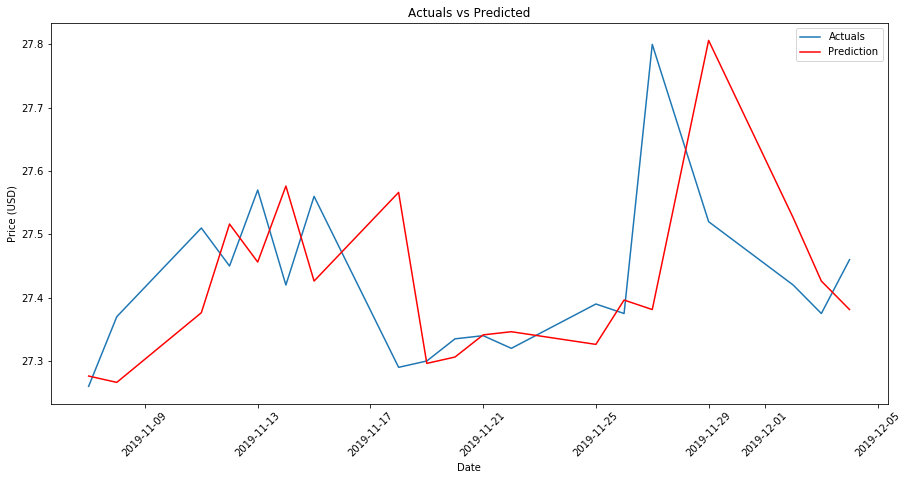

In [40]:
# Print accuracy  metrics
mse = metrics.mean_squared_error(Y_test, Y_pred)
print('Test MSE: {}'.format(round(mse, 3)))
print('Test RMSE: {}'.format(round(np.sqrt(mse), 3)))
mae = metrics.mean_absolute_error(Y_test, Y_pred)
print('Test MAE: {}'.format(round(mae, 3)))

# Calculate the closing price based on the predicted change
closing_prices = df['close'][-20:-1]

predicted_close = []
for i, x in enumerate(closing_prices):
    x = x + Y_pred[i]
    predicted_close.append(x)

# Plot the stock price prediction vs actual
plt.figure(figsize=(15, 7))
plt.plot(df.index[780:], df['close'].iloc[-19:], label='Actuals')
plt.plot(df.index[780:], predicted_close, color='red', label='Prediction')

plt.title('Actuals vs Predicted')
plt.ylabel('Price (USD)')
plt.xlabel('Date')
plt.xticks(rotation=45)
plt.legend()

plt.show()

## Analyzing Gradient Boosting Results
Overall, the accuracy of the boosting model was great. The accuracy measures were all extremely low and the prediction fit the actuals well. One noticeable trend is that the prediction line has a one day lag to the actuals. Let see if the other models provide better results.

# Convolutional Neural Network (CNN)
A CNN is a deep learning algorithm that takes an input image and assigns weights and bias to different aspects to assign importnace. Recently, it as been used for time series data due to its ability to predict patterns. Lets see how well it does with the stock data obtained. 

In [41]:
# Split train and test data
train_set = df.head(790)
test_set = df.tail(11)

# Split target variable from features, standardize the features
# Add third dimension for CNN
train_features = train_set.drop('close_diff', axis=1)
X_train = StandardScaler().fit_transform(train_features)
X_train = np.expand_dims(X_train, axis=2)
Y_train = df['close_diff'].iloc[:790]

# Split target variable from features, standardize the features
# Add third dimension for CNN
test_features = test_set.drop('close_diff', axis=1).iloc[:10]
X_test = (test_features - train_features.mean()) / train_features.std()
X_test = np.expand_dims(X_test, axis=0)
Y_test = test_set['close_diff'].iloc[-10:]

### Reshape
Now that the train and test data has been split, the sets need to be reshaped. The data will be reshaped to the following (batches, steps, channels). The steps are how many days for each batch, in this case 10 due to our holding period. The batches is total rows in the training data divided by the steps, and the channels are the number of features.

In [42]:
# Reshape the training data to fit CNN model
X_train_reduced = X_train.reshape(79, 10, 14)
X_train_reduced = np.delete(X_train_reduced, 78, axis=0)
Y_train_reduced = Y_train[10:790:10]

## Architecture

### Activation Function
The activation function is responsible for transforming the weighted input into the node. Rectified linear unit (RELU) was chosen as the activation function. RELU is a nonlinear function that allows complex relationships to be learned. It provides sensitivity to the activation sum and avoids saturation by outputting the input directly if positive otherwise it will output zero. This means that the neural network will have computational simplicity, representation sparsity (capable of outputting zero), linear behavior, and train deep networks.

### Optimizer
The optimizer algorithm chosen is Adam. Adam is a method for efficient stochastic optimization. The method computes individual adaptive learning rates for different parameters from estimates. It combines the advantages of AdaGrad and RMSProp. This leads to several advantages:

1. Straightforward to implement
2. Computationally efficient
3. Little memory required
4. Invariant to diagonal rescale of the gradients
5. Hyper-parameters have intuitive interpretation and typically require little tuning

### Layers
There are several key terms one needs to understand when building a CNN. First is the convolutional layer. This layer is a filter that moves across the data extracting high level features. In terms of our model it will move through the data 78 times with a shape of (10 days, 14 features). The output of this operation is reduced dimensionality by default. 

Next is the pooling layer. This layer decreases computational power required to process data and further extracts dominant features. Max pooling was chosen to return the maximum value from the portion of the data covered. Another great feature of max pooling is that it also removes a lot of the noise from within the data. 

The last set of features in the architecture is flatten and dense. Flatten removes all dimensions except for one. Dense is an additional layer of neurons in a neural network. It receives input from all the neurons in the previous layer, hence densely connected.

In [43]:
model = Sequential()

# Create convolutional layer
# I: [38, 20, 14], O: [ , 6, 50]
model.add(Conv1D(filters=50, kernel_size=5, activation='relu', input_shape=(10, 14)))

# Create pooling layer
# I:[ , 6, 50], O:[ , 3, 50]
model.add(MaxPooling1D(padding='same'))

# Add additional convolutional and pooling layers
# I:[ , 3, 50], O:[ , 1, 50]
model.add(Conv1D(filters=50, kernel_size=3, activation='relu', input_shape=(10, 14)))
model.add(MaxPooling1D(padding='same'))

# Add additional convolutional and pooling layers
# I:[ , 1, 50], O:[ , 1, 50]
model.add(Conv1D(filters=50, kernel_size=1, activation='relu', input_shape=(10, 14)))
model.add(MaxPooling1D(padding='same'))

# Add flatten and dense layers
model.add(Flatten())
model.add(Dense(1, activation='linear'))

model.compile(optimizer='adam', loss='mse', metrics=['mae', 'mape', 'acc'])

# fit model
model.fit(X_train_reduced, Y_train_reduced, batch_size = 100, epochs=1000, verbose=0, validation_split = 0.05,)

# Print summary
model.summary()

# Fit test data
Y_pred = model.predict(X_test)
Y_pred = np.array(Y_pred).ravel()
print(Y_pred)

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_4 (Conv1D)            (None, 6, 50)             3550      
_________________________________________________________________
max_pooling1d_4 (MaxPooling1 (None, 3, 50)             0         
_________________________________________________________________
conv1d_5 (Conv1D)            (None, 1, 50)             7550      
_________________________________________________________________
max_pooling1d_5 (MaxPooling1 (None, 1, 50)             0         
_________________________________________________________________
conv1d_6 (Conv1D)            (None, 1, 50)             2550      
_________________________________________________________________
max_pooling1d_6 (MaxPooling1 (None, 1, 50)             0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 50)               

In [44]:
# Print predicted price against actual
print('The acutal close price of {} stock: {}'.format(
    watch_list[0], df['close'][-1]))

print('The predicted price of {} stock: {}'.format(
    watch_list[0], (df['close'][-2]+Y_pred)))

# Print Statistics
mse = (Y_test[-1]-Y_pred)**2
print('MSE: {}'.format(mse))
print('Test RMSE: {}'.format(np.sqrt(mse)))
mae = Y_pred - Y_test[-1]
print('Test MAE: {}'.format(mae))
mape = ((Y_test[-1] - Y_pred) / Y_test[-1])
print('Test MAPE: {}'.format(mape))

The acutal close price of GNTX stock: 27.46
The predicted price of GNTX stock: [27.290154]
MSE: [0.02884816]
Test RMSE: [0.16984746]
Test MAE: [-0.16984746]
Test MAPE: [1.9982054]


## Analyzing CNN Results
Most of these models were run several times with multiple different tickers while building out this project. Out of all the models the CNN performed the worst. The forecasted price was all over the place. This is most likely due to having a small sample size of only 78 groups to train on. Several attempts were made to create a complex and robust neural network by adding additional layers. Surprisingly for PEGI, the CNN also had similar results to the boosting model, but it could only predict one data point due to the lack of data. Unfortunately, due to the unreliability of this model with the dataset used one should not use this model.

# Long Short-Term Memory (LSTM)
An LSTM has similar control flow to a Recurrent Neural Network. It processes data passing on information as it propagates forward. The difference is that LSTM learns to keep only relevant information to make predictions and forget non-relevant data. The architecture implemented below is simple and straightfoward. The first layer is the LSTM layer, followed by a drop out layer, and lastly a dense layer. A drop out layer ingores a random percentage of neurons during the training phase to reduce overfitting.  

In [45]:
# Split train and test data
train_set = df.head(780)
test_set = df.tail(20)

# Split target variable from features, standardize the features
# Add third dimension for LSTM
train_features = train_set.drop('close_diff', axis=1).iloc[0:779]
X_train = StandardScaler().fit_transform(train_features)
X_train = np.expand_dims(X_train, axis=2)
Y_train = df['close_diff'].iloc[1:780]

# Split target variable from features, standardize the features
# Add third dimension for LSTM
test_features = test_set.drop('close_diff', axis=1).iloc[0:19]
X_test = (test_features - train_features.mean()) / train_features.std()
X_test = np.expand_dims(X_test, axis=2)
Y_test = test_set['close_diff'].iloc[1:]

In [46]:
model = Sequential()

# Add LSTM layer
model.add(LSTM(30, input_shape=(14, 1)))

# Dropout ratio is .2
model.add(Dropout(0.2))
model.add(Dense(1, activation='linear'))
model.compile(optimizer='adam', loss='mse', metrics=['mae', 'mape', 'acc'])

# Fit model
history = model.fit(X_train, Y_train, epochs=1000, batch_size=100, verbose=0, shuffle=False)

# Print summary
model.summary()

# Fit test data
Y_pred = model.predict(X_test)

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_2 (LSTM)                (None, 30)                3840      
_________________________________________________________________
dropout_2 (Dropout)          (None, 30)                0         
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 31        
Total params: 3,871
Trainable params: 3,871
Non-trainable params: 0
_________________________________________________________________


Test MSE: 0.088
Test RMSE: 0.297
Test MAE: 0.255


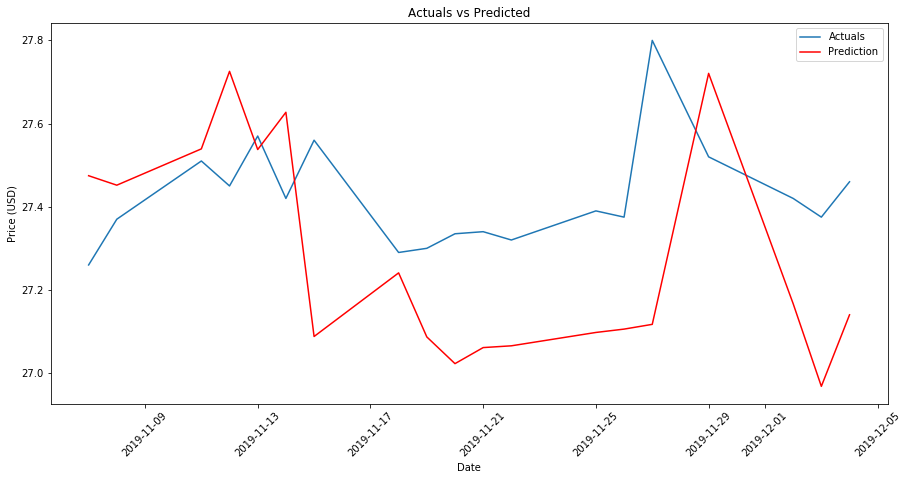

In [47]:
# Print accuracy metrics
mse = metrics.mean_squared_error(Y_test, Y_pred)
print('Test MSE: {}'.format(round(mse, 3)))
print('Test RMSE: {}'.format(round(np.sqrt(mse), 3)))
mae = metrics.mean_absolute_error(Y_test, Y_pred)
print('Test MAE: {}'.format(round(mae, 3)))

# Calculate the closing price based on the predicted change
closing_prices = df['close'][-20:-1]

predicted_close = []
for i, x in enumerate(closing_prices):
    x = x + Y_pred[i]
    predicted_close.append(x)

# Plot the stock price prediction vs actual
plt.figure(figsize=(15, 7))
plt.plot(Y_test.index, df['close'].iloc[-19:], label='Actuals')
plt.plot(Y_test.index, predicted_close, color='red', label='Prediction')

plt.title('Actuals vs Predicted')
plt.ylabel('Price (USD)')
plt.xlabel('Date')
plt.xticks(rotation=45)
plt.legend()

plt.show()

## Analyzing LSTM Results
The LSTM ran for 1000 epochs, but it still performed poorly. The accuracy of the predictions is the first problem of this model. It overreacted to each change in price for the stock. 

# ARIMA
ARIMA model is a class of statistical models for analyzing and forecasting time series data. It stands for AutoRegressive Integrated Moving Average. Lets breakdown each element below:

1. AR: Autoregression. It is a model that uses the dependant relationship between an observation and number of lagged observations.
2. I: Integrated. Use of differencing of raw observations.
3. MA: Moving Average. A model that uses the dependency between an observation and a residual error from a moving average model applied to the lagged observations. 

Each of these components apply to a specific parameter (p, d, q)

## PACF
ACF is an auto-correlation function which gives us values of auto-correlation of a series with its lagged values. It describes how well the present value of a series is related with its past values. PACF is a partial auto-correlation function. It finds correlation of residuals with the next lag value. The closing price times series show a strong correlation to one prior date, while the differences show no real autocorrelation. Based on these charts, the ideal ARIMA parameters could be (0, 1, 0).

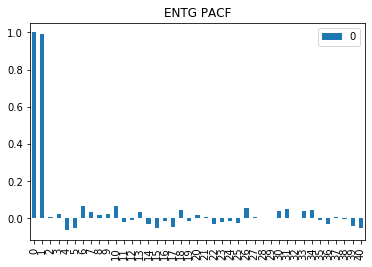

In [48]:
# Plot PACF for unstationary stock close prices
x_acf = pd.DataFrame(pacf(df['close']))
x_acf.plot(kind='bar')
plt.title("ENTG PACF")
plt.show()

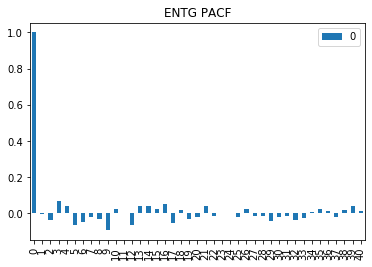

In [49]:
# Plot PACF for stationary stock close prices
x_acf = pd.DataFrame(pacf(df['close_diff']))
x_acf.plot(kind='bar')
plt.title("ENTG PACF")
plt.show()

## Auto ARIMA
While randomly plugging numbers could eventually succeed, there is a more efficient method to find the ideal arima parameters. The auto arima model below will search for the best model between p and q values of 1-20. The models will test stationary the stationary stock time series data to see which has the best fit. As identified below the best fitting ARIMA model had the parameters of (2, 1, 2). 

In [50]:
# Run auto ARIMA to get ideal parameters
stepwise_model = auto_arima(df['close_diff'], start_p=1, start_q=1,
                           max_p=20, max_q=20, m=1,
                           start_P=1, seasonal=True,
                           d=1, max_d=1, D=1,
                           error_action='ignore',  
                           suppress_warnings=True, 
                           stepwise=True)

print(stepwise_model)

# Append ideal auto ARIMA parameters to list
tmp = stepwise_model.get_params('order')
order = tmp.get('order')

ARIMA(callback=None, disp=0, maxiter=None, method=None, order=(0, 1, 1),
      out_of_sample_size=0, scoring='mse', scoring_args=None,
      seasonal_order=(0, 0, 0, 1), solver='lbfgs', start_params=None,
      suppress_warnings=True, transparams=True, trend=None,
      with_intercept=True)


In [51]:
# Get the values of target variables
df1= df['close_diff']
X = df1.values

# Split data from train and test
train, test = X[:-19], X[-19:]
history = [x for x in train]

# Fit and predict ARIMA based on values from Auto ARIMA
predictions = list()
for t in range(len(test)):
    model = ARIMA(history, order=order)
    model_fit = model.fit(disp=0)
    output = model_fit.forecast()
    yhat = output[0]
    predictions.append(yhat)
    obs = test[t]
    history.append(obs)

Test MSE: 0.024
Test RMSE: 0.155
Test MAE: 0.114
Test MAPE: 162.525


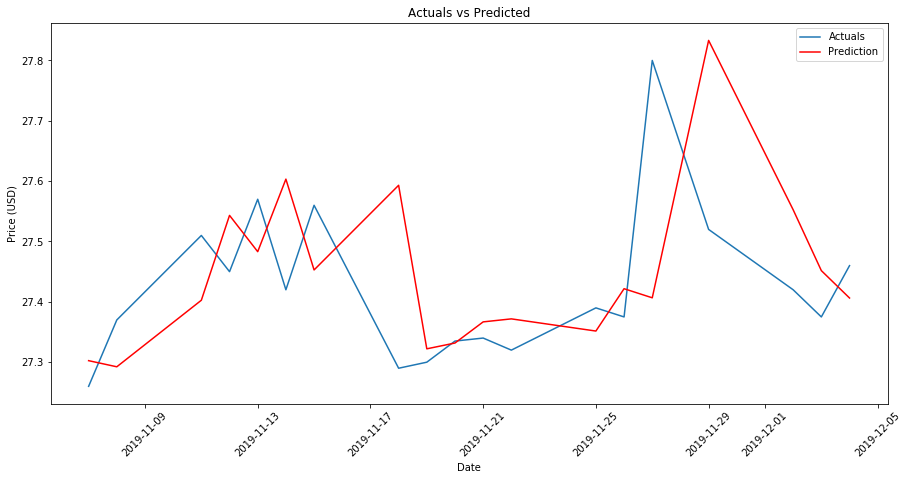

In [52]:
# Print accuracy statistics
mse = metrics.mean_squared_error(test, predictions)
print('Test MSE: {}'.format(round(mse, 3)))
print('Test RMSE: {}'.format(round(np.sqrt(mse), 3)))
mae = metrics.mean_absolute_error(test, predictions)
print('Test MAE: {}'.format(round(mae, 3)))
mape = np.mean(np.abs((test - predictions) / test)) * 100
print('Test MAPE: {}'.format(round(mape, 3)))

# Calculate the closing price based on the predicted change
closing_prices = df['close'][-20:-1]

predicted_close = []
for i, x in enumerate(closing_prices):
    x = x + predictions[i]
    predicted_close.append(x)

# Plot the stock price prediction vs actual
plt.figure(figsize=(15, 7))
plt.plot(df1.index[-19:], df['close'][-19:], label='Actuals')
plt.plot(df1.index[-19:], predicted_close, color='red', label='Prediction')

plt.title('Actuals vs Predicted')
plt.ylabel('Price (USD)')
plt.xlabel('Date')
plt.xticks(rotation=45)

# Plot Legend
plt.legend()

plt.show()

## Analyzing ARIMA Results
The ARIMA model performed well. For the most part, it followed the shape of the close prices just lagged by 1 day. In terms of accuracy it had low MSE, RMSE, and MAE values. The MAPE on the other had was fairly larger. 

# Gradient Boosting Forcasting
Out of the four models the two best performing models were gradient boosting and ARIMA. Of these two, gradient boosting was the superior model for several reasons:
    1. It had better accuracy in terms of predicting the stock price
    2. It was not as reactive as the ARIMA model
    3. It predicted a higher price than the range. This is important as the forecast needs to predict a forecast
    
The function below runs each stock in the watchlist through the hyperparameter tuning as shown in the gradient boosting section. The model will predict tomorrow's stock price, and the ROI will be calculated based on today's close price. The goal of this function is to reduce the watchlist to the top three stocks to potentially start a position in.

In [28]:
# Return top 3 stocks on watch list with forecasted return
roi, forecast = roi_calc(watch_list, api, random_grid)

Top 3 Forecasted ROI:
SO: [0.08646138]% Forecasted gain
Forecasted Price: SO
PAYX: [0.03533041]% Forecasted gain
Forecasted Price: PAYX
GNTX: [0.02769098]% Forecasted gain
Forecasted Price: GNTX

--- 3673.088215827942 seconds ---


# Summary and Conclusion
The goal of this project was not to attempt to create an alogrithm that could predict the market, or a specific stock price, correctly 100 percent of the time. As that is impossible due to the thousands of different variables that could impact the stock price. Additionally, one could create more complex and robust features such as implementing natural language processing on stock and market news or adding economic scores(job reports, industry reports, etc.) into the model. The issue is that this just increases the noise and complexity of the model, with limited expected incremental returns. Most professional traders have a trade success rate between 30-40 percent. The secret is knowing one's trading style:
    1. Success rate
    2. Average gain
    3. Average loss
    4. Preferred number of trades in day / week / month
    5. Ideal entry and exit
    
By knowing these numbers, a professional trader can make better decisions and better control their emotions. The goal for this project was to help identify stocks with an ideal pattern set up, within a reasonable buy and stop range, with a general ROI forecast for the stock's price on the following day. Additionally, and more importantly, this project reduces the amount of personal bias and emotional trading otherwise associated with stock picking. The goal now is to further test this with paper trading simulation to see how it performs in real time to see if one can increase their success rate ever so slightly.  

## References
NASDAQ - https://www.nasdaq.com/market-activity/stocks

Tiingo - https://api.tiingo.com/

CNN - https://machinelearningmastery.com/how-to-develop-convolutional-neural-network-models-for-time-series-forecasting/

LSTM - https://www.analyticsvidhya.com/blog/2017/12/fundamentals-of-deep-learning-introduction-to-lstm/